# PCA Analysis

## 1. Import Essential Packages

In [1]:
# Import essential packages
import warnings
warnings.filterwarnings("ignore")
import os
import missingno
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# sklearn helper modules
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Plotting settings
# In case the font Cambria is not locally installed in you system, 
# comment out the line below
plt.rcParams['font.serif'] = "Cambria"
plt.rcParams['font.family'] = "serif"
plt.rcParams['font.size'] = 14
plt.rcParams['axes.grid'] = True
plt.rcParams['figure.figsize'] = 10,6

# Set seed for reproducilibity
np.random.seed(0)

# Define paths that are necessary
DPATH = "../data/"
RPATH = "../results/"
IPATH = "../images/"

if "data" not in os.listdir("../"):
    os.mkdir(DPATH)
if "images" not in os.listdir("../"):
    os.mkdir(IPATH)
if "results" not in os.listdir("../"):
    os.mkdir(RPATH)

In [2]:
df = pd.read_csv(DPATH+"cleaned_data.csv", index_col=0)
X = df[df.columns[2:-1]].values
df

,strain_slug,region,tot_thc,tot_cbd,tot_cbg,tot_cbc,tot_cbn,tot_thcv,tot_ocimene,camphene,...,caryophyllene,limonene,linalool,myrcene,bisabolol,b_pinene,a_terpinene,terpinolene,a_pinene,region_index
u_id,,,,,,,,,,,,,,,,,,,,,
0,Sample_0,AK,0.934875,0.002195,0.051035,0.000000,0.0,0.011895,0.126627,0.005041,...,0.282619,0.080244,0.016521,0.089255,0.014919,0.057590,0.005041,0.161961,0.038028,0
1,Sample_1,AK,0.942376,0.004544,0.047952,0.002478,0.0,0.002651,0.215732,0.005758,...,0.181566,0.073240,0.005758,0.115024,0.005758,0.040225,0.007331,0.210494,0.035078,0
2,Sample_2,AK,0.942578,0.004096,0.047829,0.002907,0.0,0.002590,0.208189,0.006220,...,0.190361,0.069086,0.013722,0.110446,0.006220,0.036003,0.007452,0.209503,0.030722,0
3,Sample_3,AK,0.966836,0.003003,0.025930,0.001726,0.0,0.002504,0.008019,0.008019,...,0.308981,0.108156,0.044945,0.295542,0.039173,0.028637,0.000000,0.000000,0.016085,0
4,Sample_4,AK,0.934829,0.003692,0.049598,0.000000,0.0,0.011880,0.129744,0.008177,...,0.259848,0.094910,0.023999,0.081292,0.008177,0.068392,0.008177,0.147166,0.046147,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88943,Sample_88943,CA,0.938651,0.002171,0.059177,0.000000,0.0,0.000000,0.000000,0.002157,...,0.290768,0.195427,0.060828,0.251079,0.029767,0.029336,0.000000,0.000000,0.017256,1
88944,Sample_88944,CA,0.950399,0.002075,0.047527,0.000000,0.0,0.000000,0.000000,0.006301,...,0.221872,0.257426,0.109811,0.207921,0.029253,0.044104,0.000000,0.008101,0.025653,1
88980,gods-gift,CA,0.969916,0.002917,0.026502,0.000665,0.0,0.000000,0.059835,0.002063,...,0.191197,0.046080,0.020633,0.366575,0.038514,0.045392,0.000000,0.000000,0.097662,1


## 2. PCA

In [3]:
# Pipeline and PCA
model = Pipeline([('scaler', StandardScaler()), ('pca', PCA())])
model.fit(X)
X_pca = model.transform(X)
np.save(DPATH+"X_pca", X_pca)
X_pca.shape

(26033, 20)

90% Variance is explained by: 13 PCs


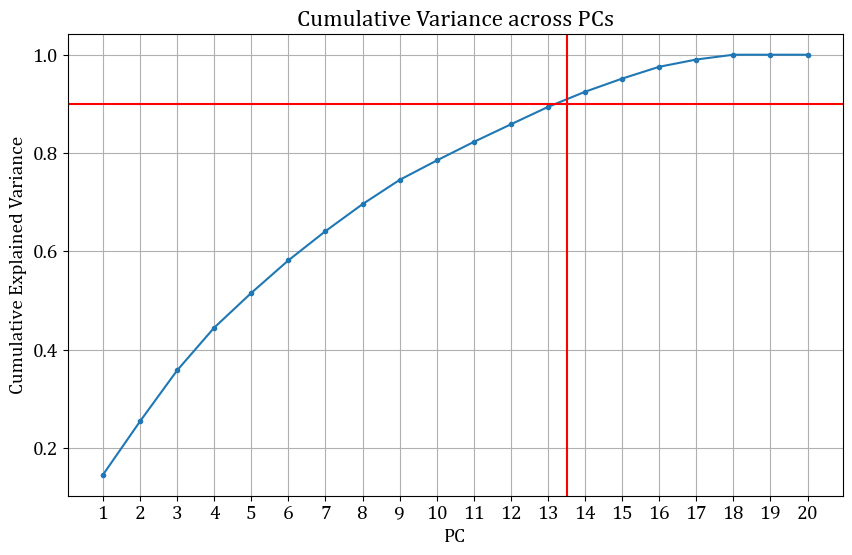

In [4]:
exp_var = model["pca"].explained_variance_ratio_
plt.plot(range(1, len(exp_var)+1), np.cumsum(exp_var), ".-", label="Cumulative Explained variance")

plt.axhline(0.9, color="r", linestyle="-")

position_x = np.where(np.cumsum(exp_var) > 0.9)[0][0]
print("90% Variance is explained by:", position_x, "PCs")
plt.axvline(position_x+0.5, color="r", linestyle="-")

plt.xticks(range(1, len(exp_var)+1))
plt.xlabel("PC")
plt.ylabel("Cumulative Explained Variance")
plt.title("Cumulative Variance across PCs")
plt.show()

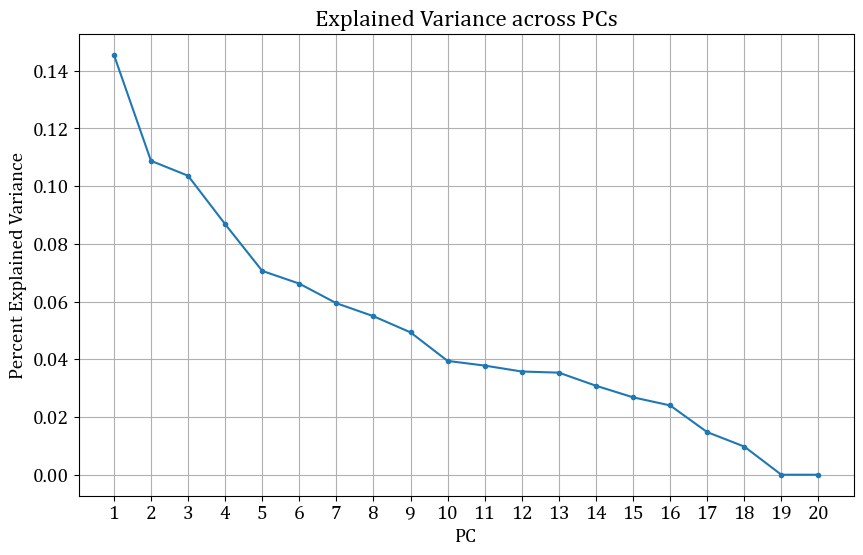

In [5]:
plt.plot(range(1, len(exp_var)+1), exp_var, ".-", label="Explained variance")
plt.xticks(range(1, len(exp_var)+1))
plt.xlabel("PC")
plt.ylabel("Percent Explained Variance")
plt.title("Explained Variance across PCs")
plt.show()

More than 90% variance is explained by the top 13 PCs

## 3. Plots

In [6]:
df_pca = pd.DataFrame(X_pca)
df_pca

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.062433,-0.460243,-0.603420,2.216522,-0.224708,-0.755822,0.337966,0.607592,1.072438,-0.722425,-0.735478,0.301455,0.293308,0.297863,0.011048,-0.128235,0.148907,0.201714,-2.228954e-15,-1.082268e-15
1,1.031236,-0.540904,0.058997,2.833693,-0.737586,-0.729527,-0.269746,1.021384,0.396900,-1.567681,-0.828087,0.640366,-0.262757,0.807264,0.458603,0.209910,0.232303,-0.222453,-1.022973e-14,-1.313102e-15
2,0.826590,-0.463258,0.082797,2.833259,-0.738011,-0.641144,-0.292399,0.972194,0.369907,-1.523084,-0.878188,0.576673,-0.262465,0.841804,0.418416,0.121402,0.232993,-0.258132,-9.695906e-15,-3.949867e-16
3,-1.583976,0.310109,-0.703823,0.157794,-0.957399,0.167425,0.416202,-0.379162,0.349257,0.210728,-0.613906,0.636723,0.334018,0.098241,-0.034086,0.048810,0.307076,0.023899,3.748103e-15,-6.195223e-16
4,0.289402,-0.635416,-0.417411,1.996998,0.070891,-0.830122,0.295792,0.601671,1.082564,-0.757326,-0.834403,0.226802,0.363847,0.318667,0.075491,0.028726,0.270407,0.293197,-4.053287e-15,-9.412306e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26028,-1.317899,0.027873,-0.795239,0.093036,-0.522831,-0.033533,-0.403551,0.231298,-0.227151,0.317428,0.004089,-0.110385,0.545300,-0.310079,-0.171283,0.086559,-0.206595,0.011612,3.052782e-15,-4.984487e-16
26029,-1.036260,-0.423486,-0.429534,-0.478657,0.267562,-0.103609,-0.895162,0.318889,-0.176502,0.389443,0.074672,-0.027180,-0.010257,-0.165904,-0.126469,-0.036079,-0.088175,-0.010292,-9.738972e-16,-1.534147e-15
26030,0.226770,0.029068,-0.455632,-0.070319,-1.402272,-0.241137,0.881339,-0.261266,0.040974,-0.124046,-0.286383,0.105127,-0.299452,0.310077,0.179927,0.280639,0.217813,-0.113776,-3.820562e-16,-1.916568e-15
26031,0.091599,-0.392028,-0.314843,-0.971147,-1.075744,0.646167,-0.844620,-0.191226,-0.033538,0.028048,0.348376,0.563091,0.346631,-0.252674,-0.124417,0.192195,0.168154,0.076592,3.798244e-15,-1.143337e-15


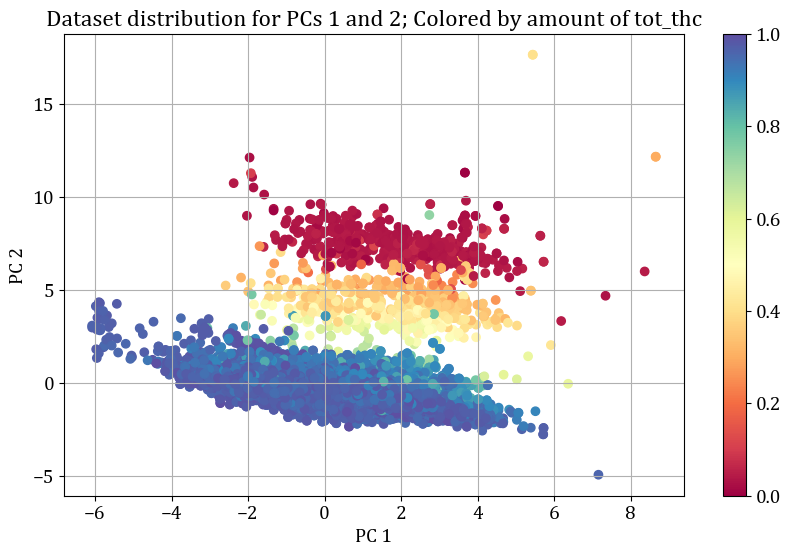

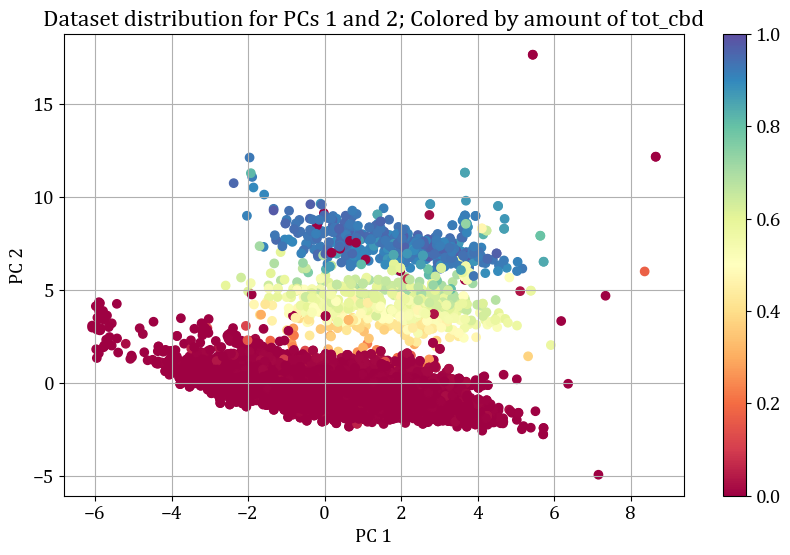

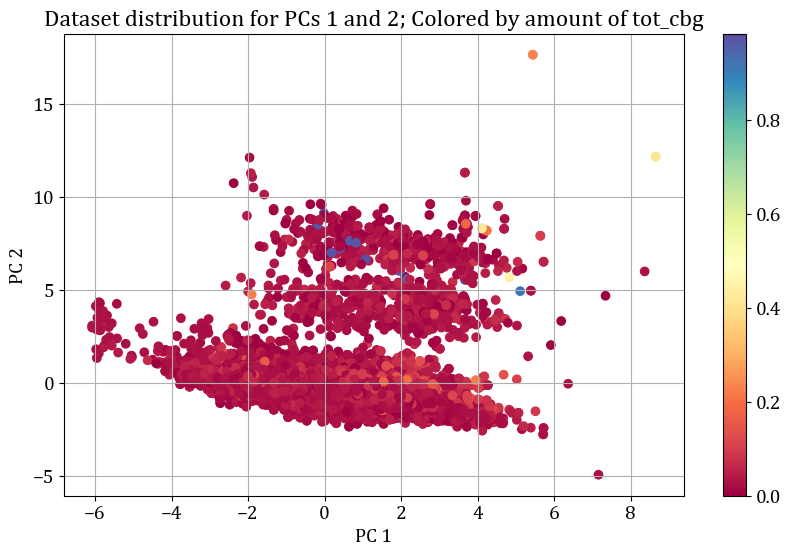

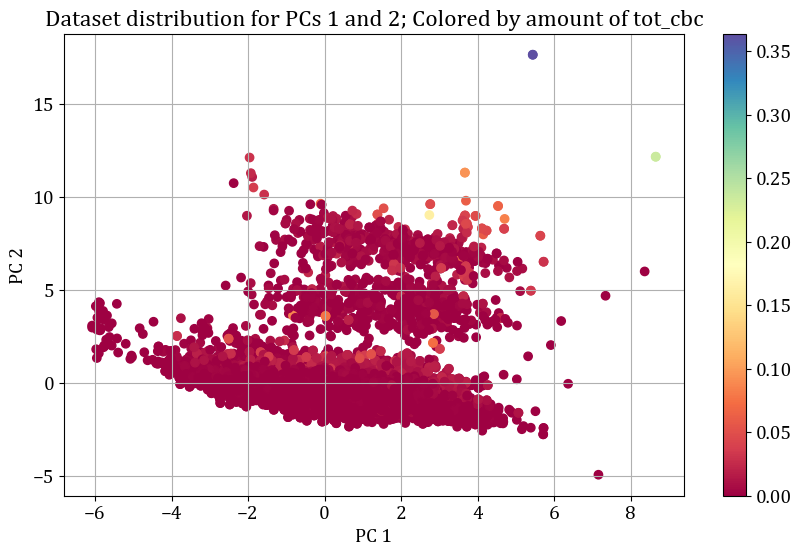

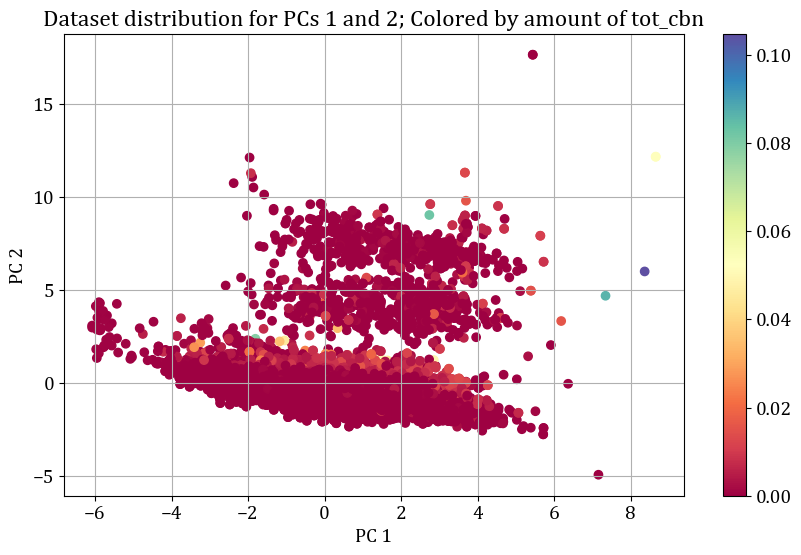

...

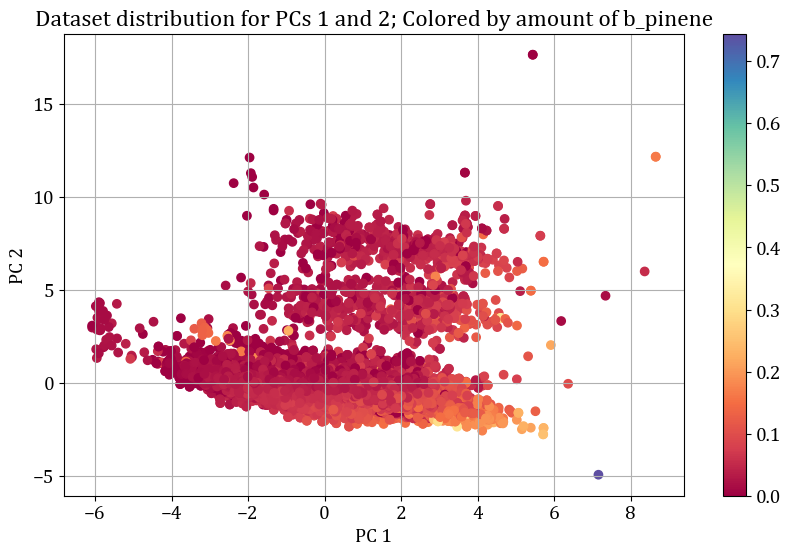

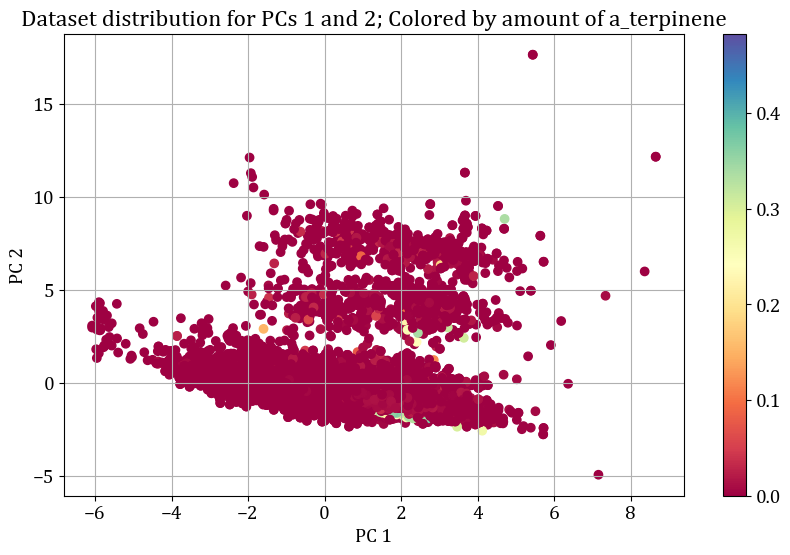

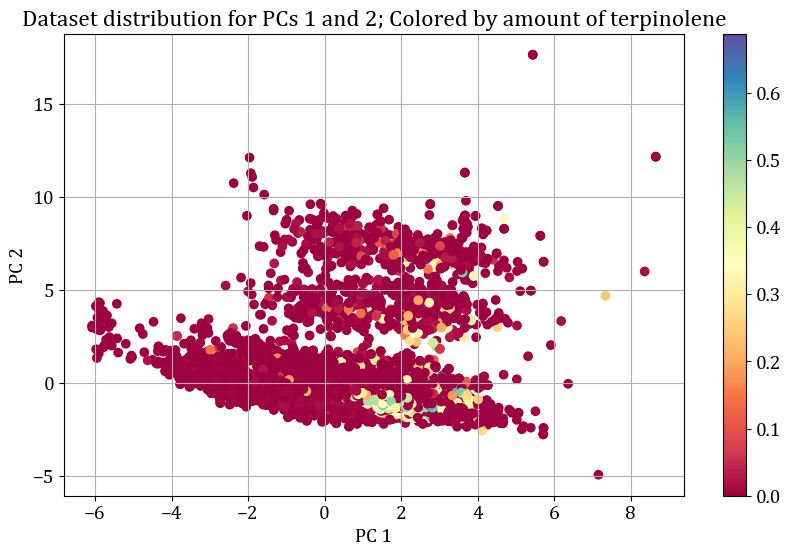

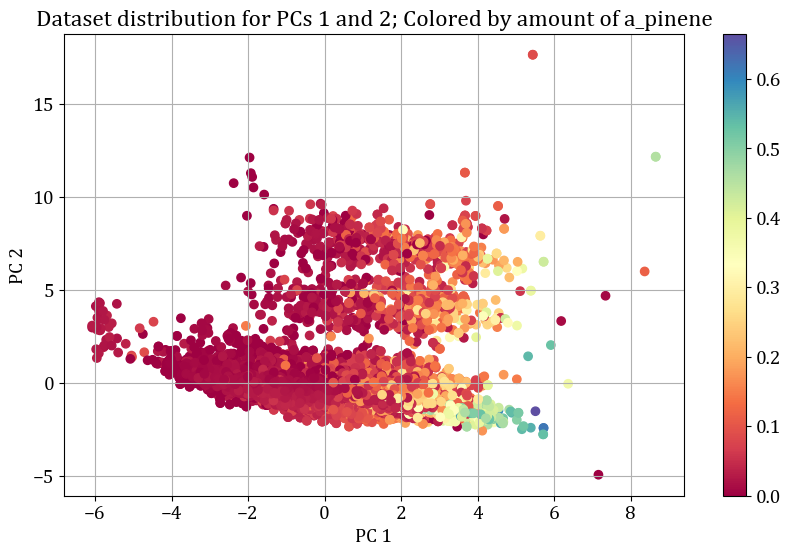

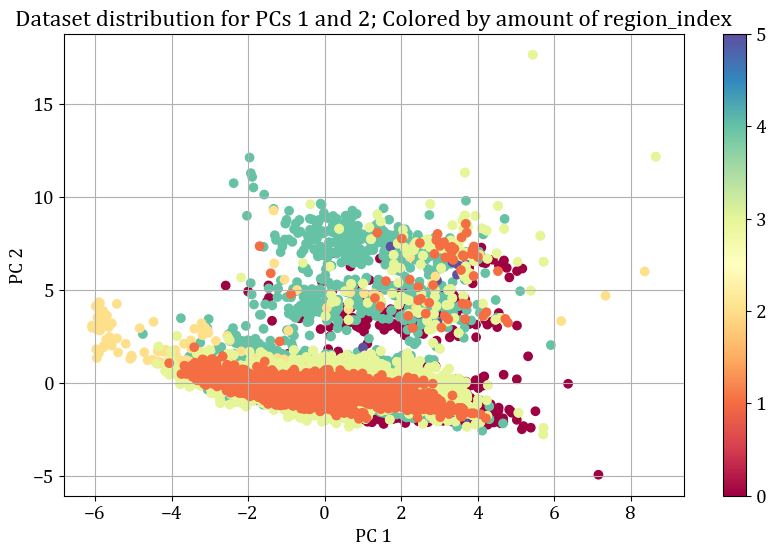

In [7]:
for i in df.columns[2:]:
    plt.scatter(df_pca[0], df_pca[1], c=df[i], cmap="Spectral")
    plt.colorbar()
    plt.xlabel("PC 1")
    plt.ylabel("PC 2")
    plt.title("Dataset distribution for PCs 1 and 2; Colored by amount of "+i)
    plt.savefig(IPATH+"PC_1_2_"+i+".png")
    plt.show()

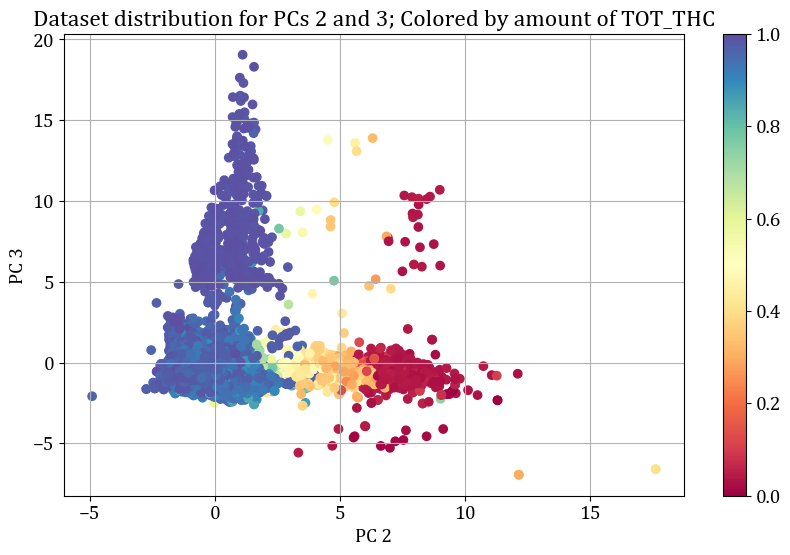

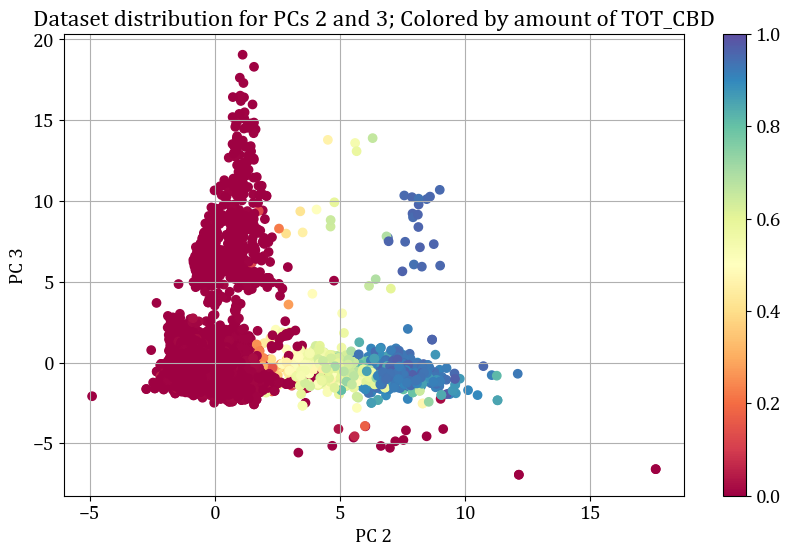

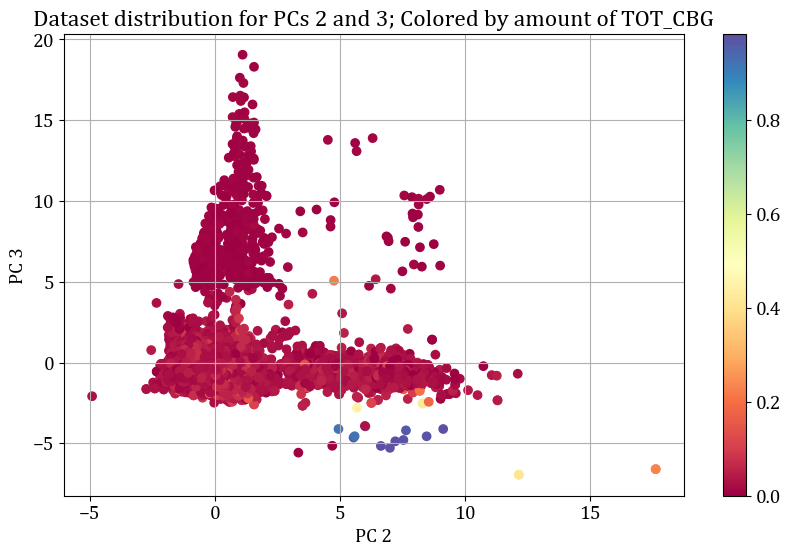

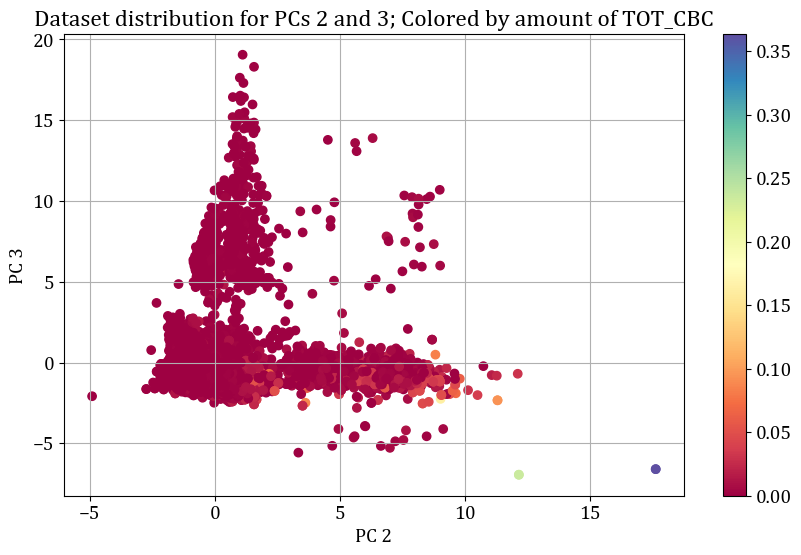

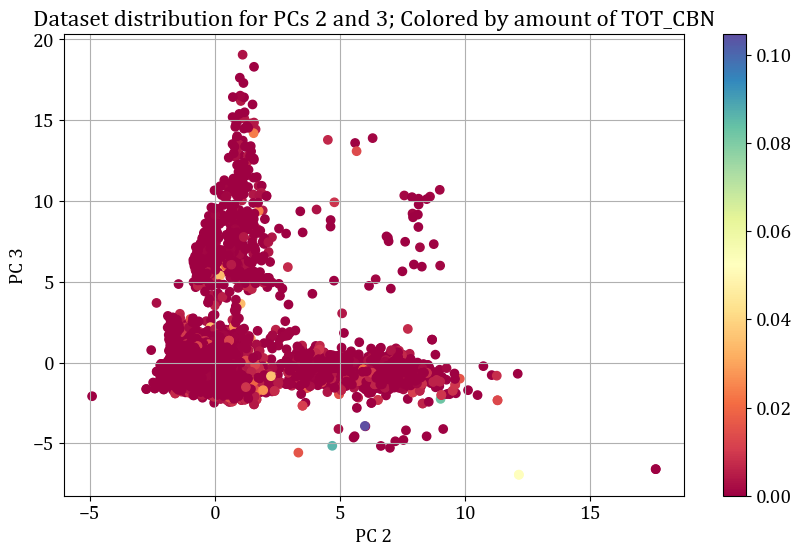

...

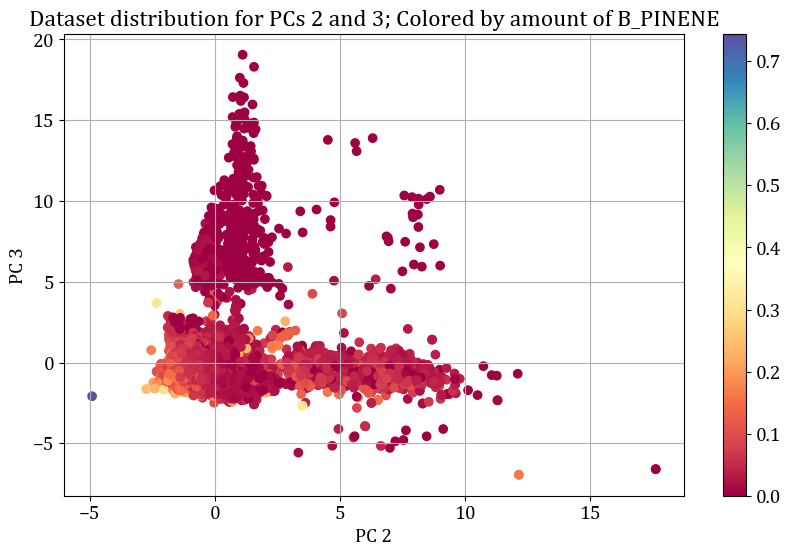

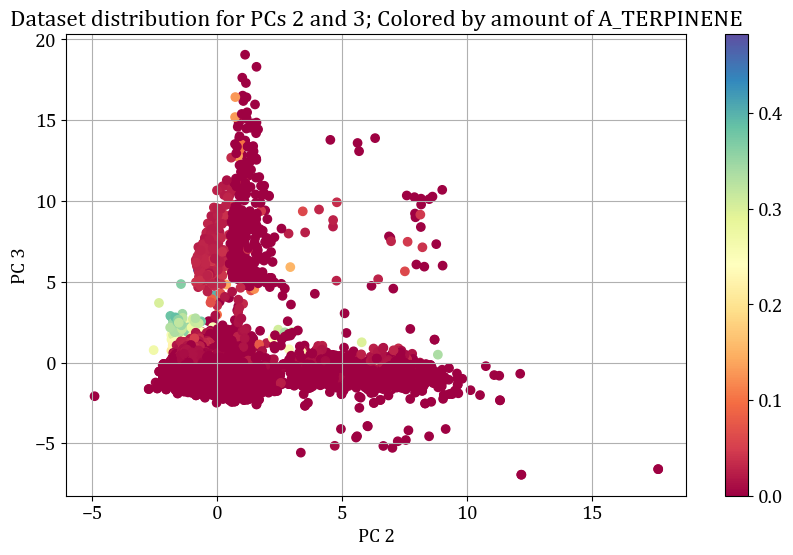

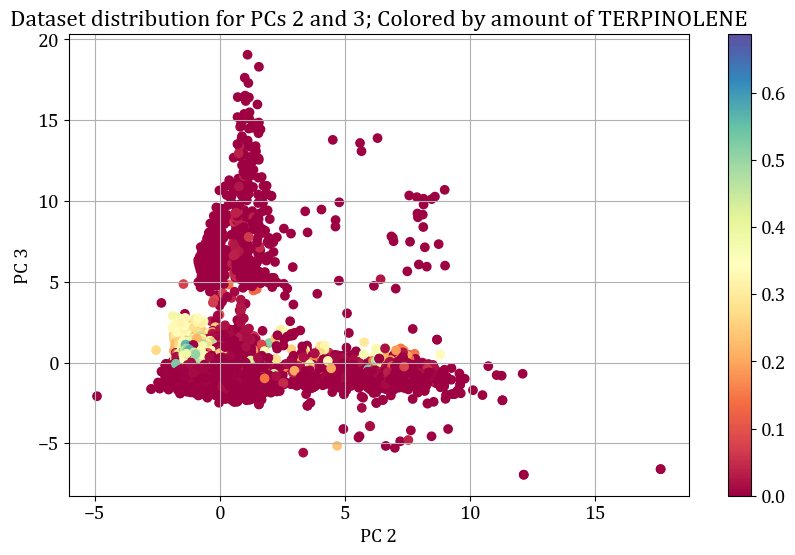

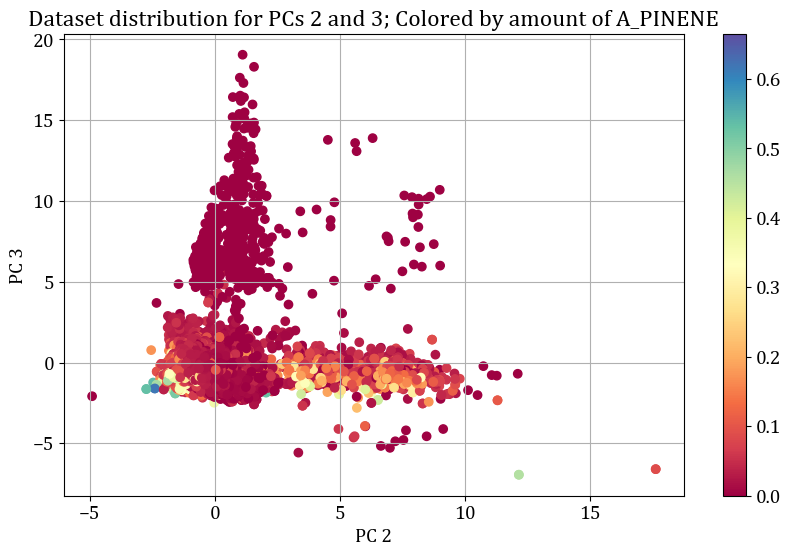

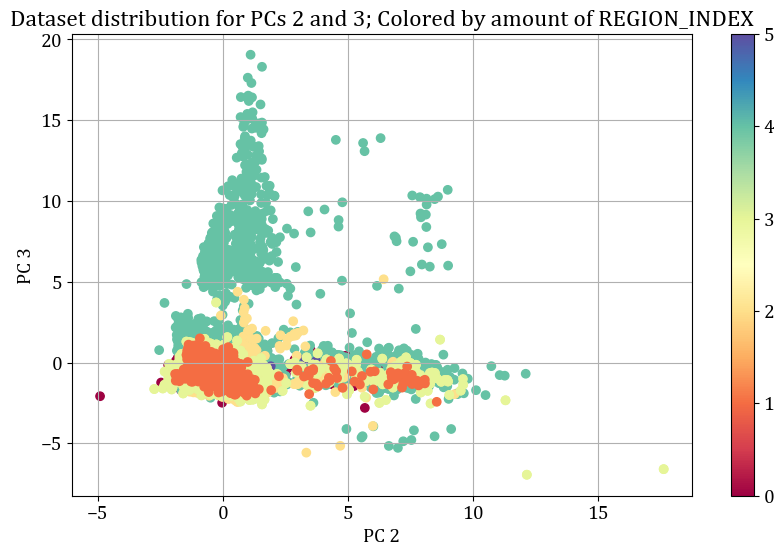

In [8]:
for i in df.columns[2:]:
    plt.scatter(df_pca[1], df_pca[2], c=df[i], cmap="Spectral")
    plt.colorbar()
    plt.xlabel("PC 2")
    plt.ylabel("PC 3")
    plt.title("Dataset distribution for PCs 2 and 3; Colored by amount of "+i.upper())
    plt.savefig(IPATH+"PC_2_3_"+i+".png")
    plt.show()

In [9]:
df["region"]

u_id
0        AK
1        AK
2        AK
3        AK
4        AK
         ..
88943    CA
88944    CA
88980    CA
88998    CA
88999    CA
Name: region, Length: 26033, dtype: object

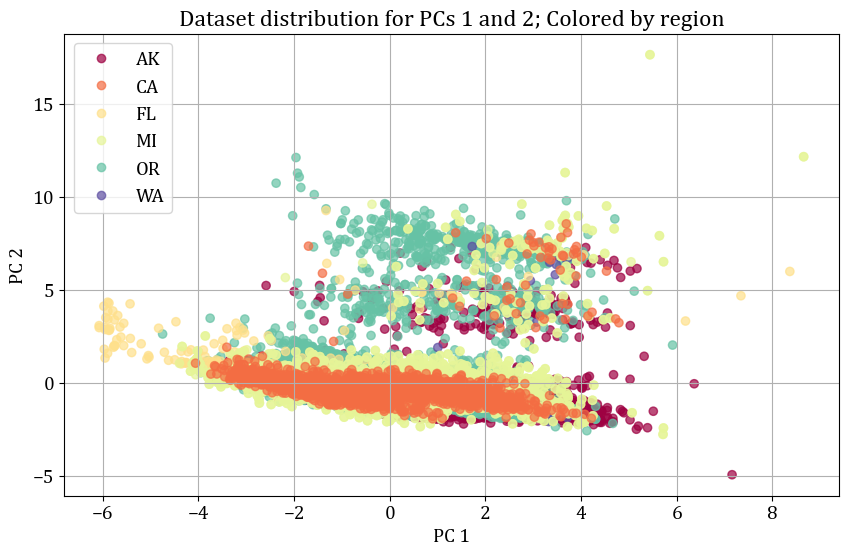

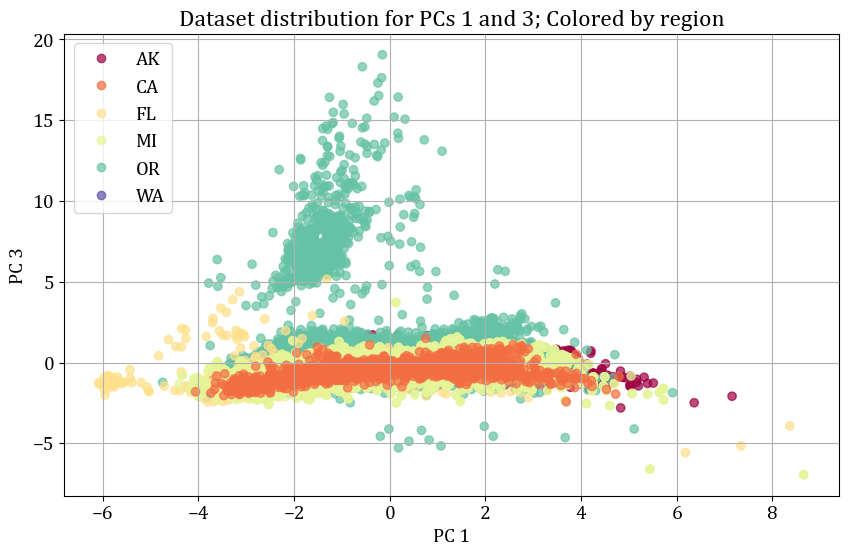

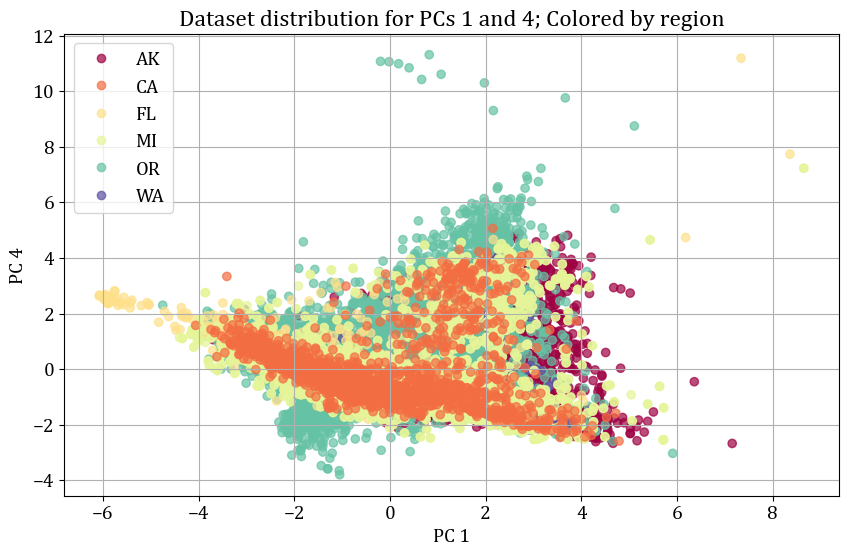

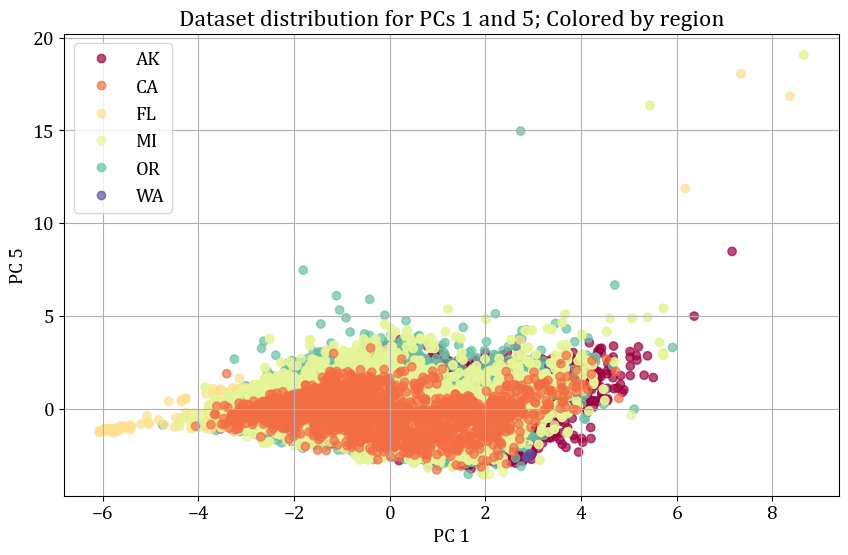

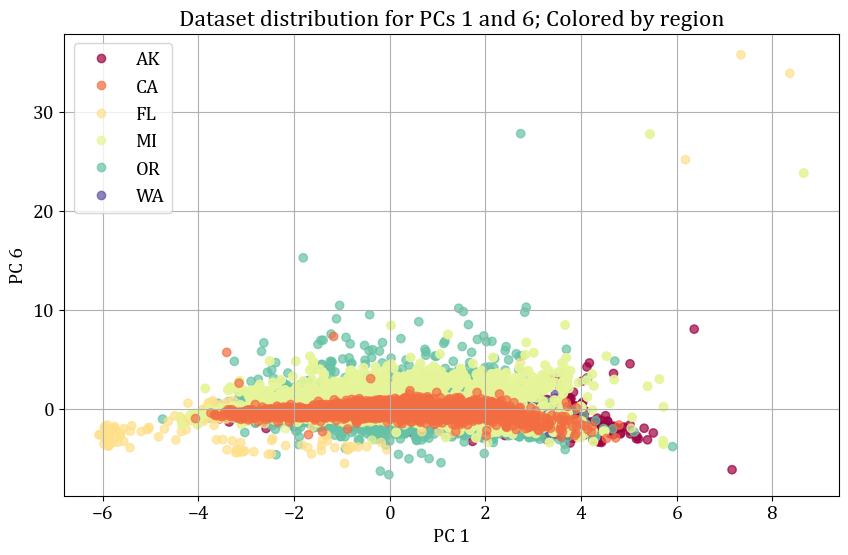

...

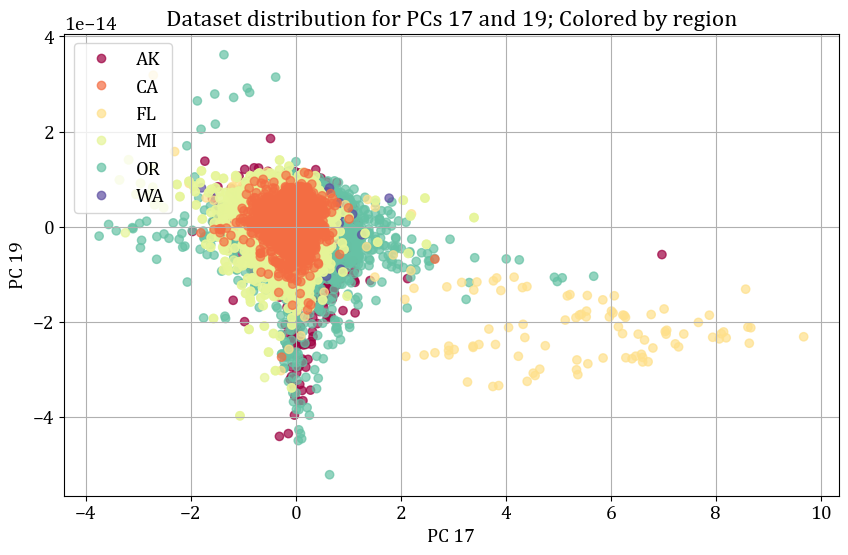

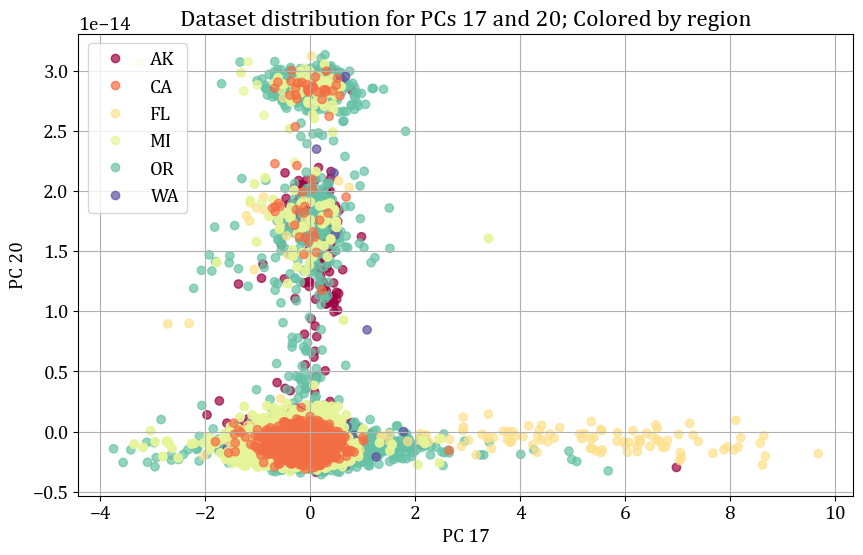

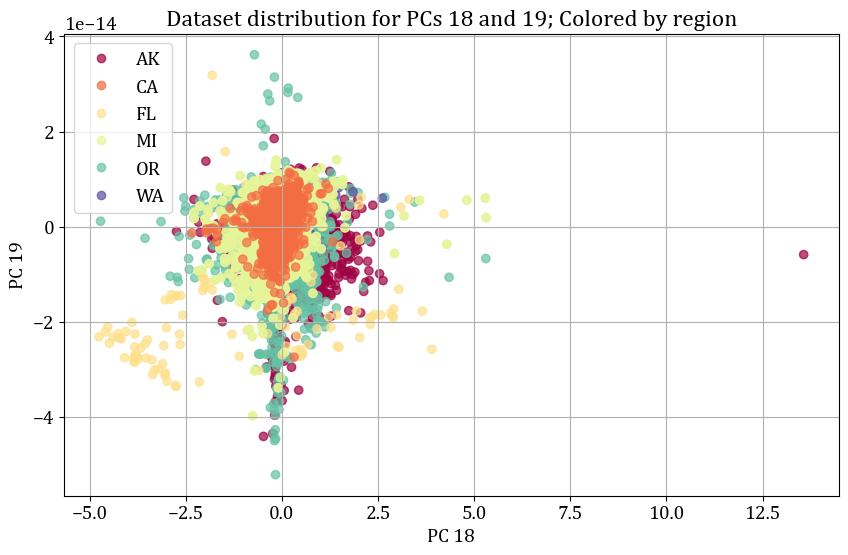

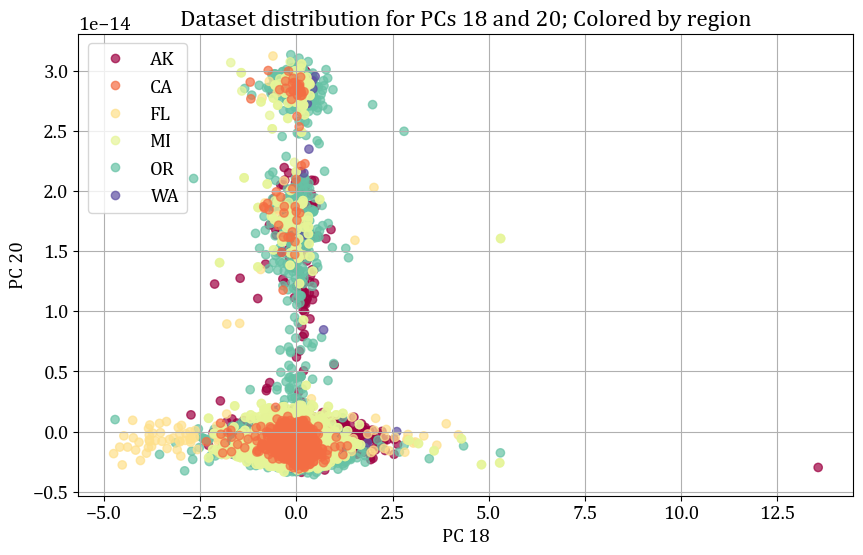

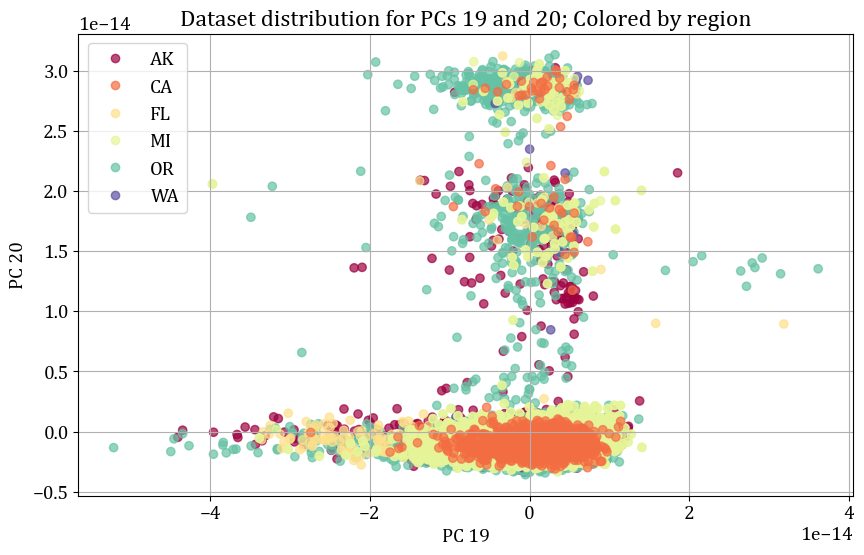

In [10]:
u, inv = np.unique(df["region"].values, return_inverse=True)

for i in range(df_pca.shape[1]-1):
    for j in range(i+1, df_pca.shape[1]):
        fig,ax = plt.subplots()
        scatter = plt.scatter(df_pca[i], df_pca[j], c=df["region_index"], cmap="Spectral", alpha=0.7)
        plt.legend(scatter.legend_elements()[0], u, loc=2)
        plt.xlabel("PC "+str(i+1))
        plt.ylabel("PC "+str(j+1))
        plt.title("Dataset distribution for PCs {} and {}; Colored by region".format(i+1, j+1))
        plt.savefig(IPATH+"PC_{}_{}_region.png".format(i+1, j+1))
        plt.show()

## 4. t-SNE

In [11]:
# Pipeline and PCA
X_scaled = StandardScaler().fit_transform(X)
model = TSNE(n_components=2)
X_tsne = model.fit_transform(X_scaled)
np.save(DPATH+"X_tsne", X_tsne)
X_tsne.shape

(26033, 2)

In [12]:
df_tsne = pd.DataFrame(X_tsne)
df_tsne

,0,1
0,58.165138,17.068592
1,55.945293,38.768299
2,55.939301,38.755657
3,-52.787331,44.424995
4,58.322582,17.107523
...,...,...
26028,-48.664124,5.576939
26029,-39.095654,-27.499594
26030,24.367369,-14.705217
26031,-10.853015,-45.076534


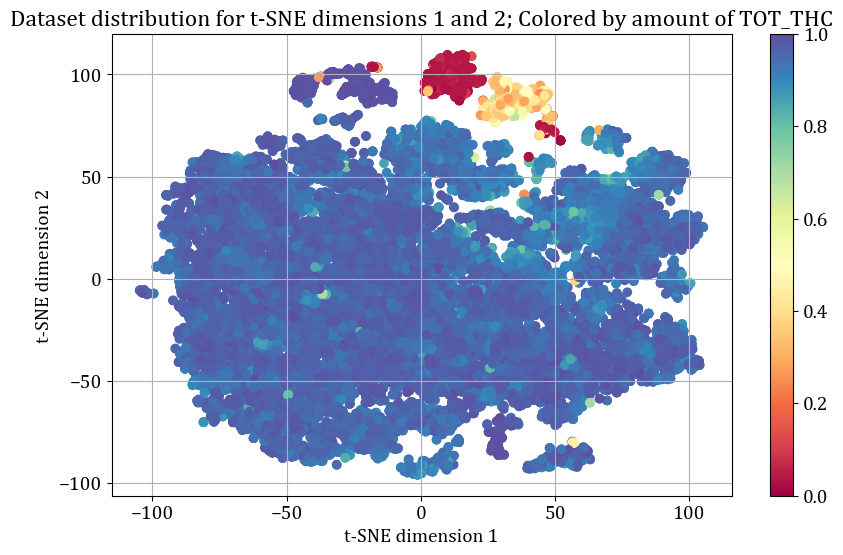

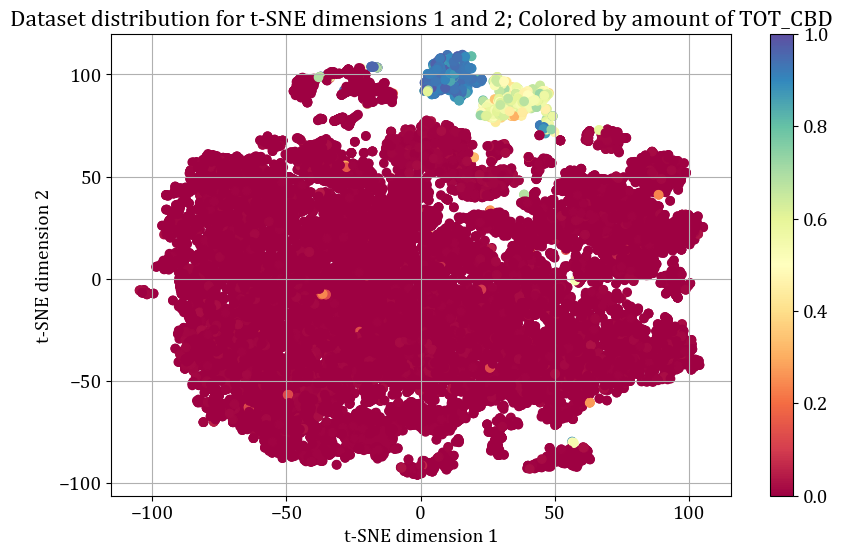

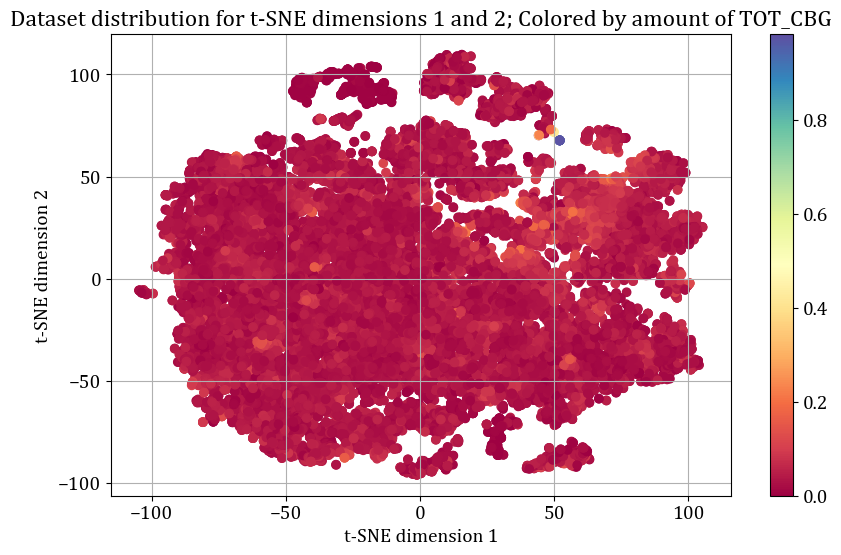

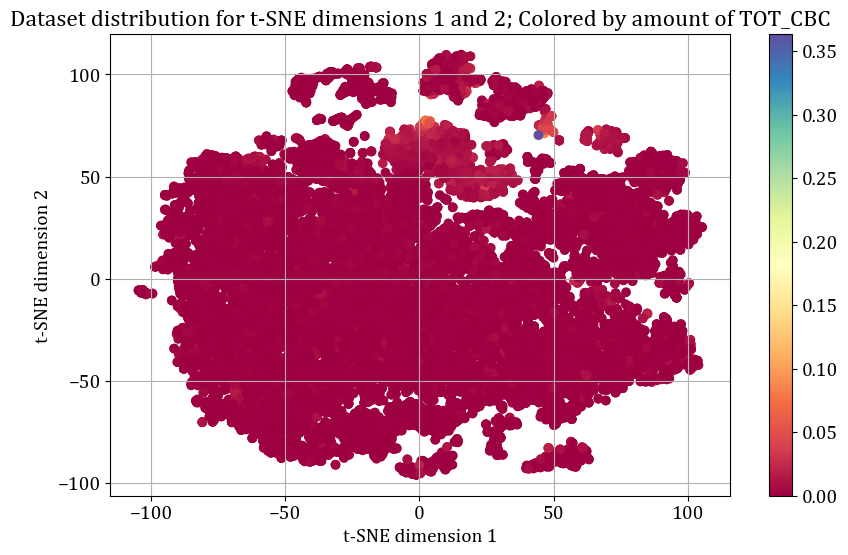

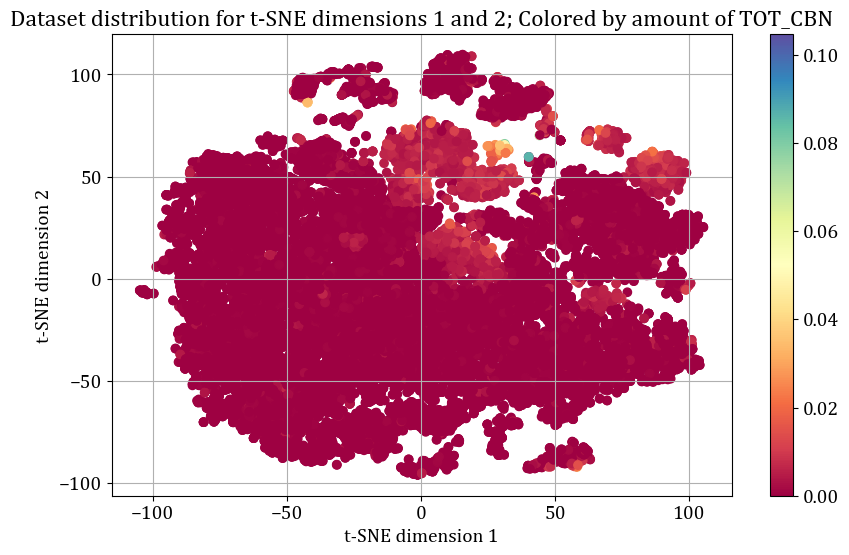

...

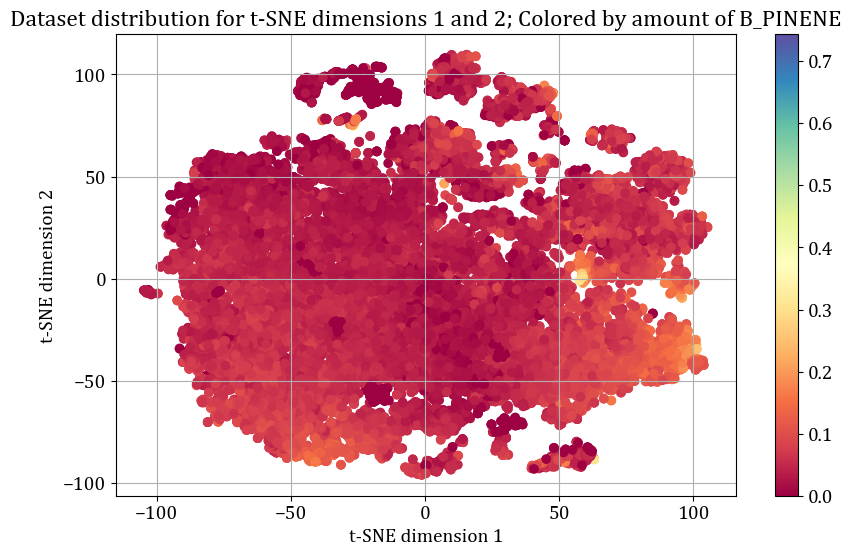

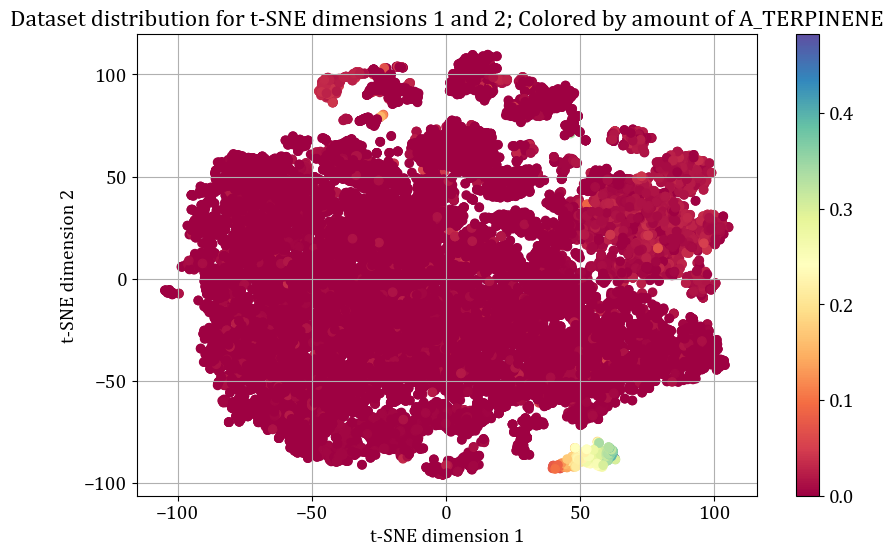

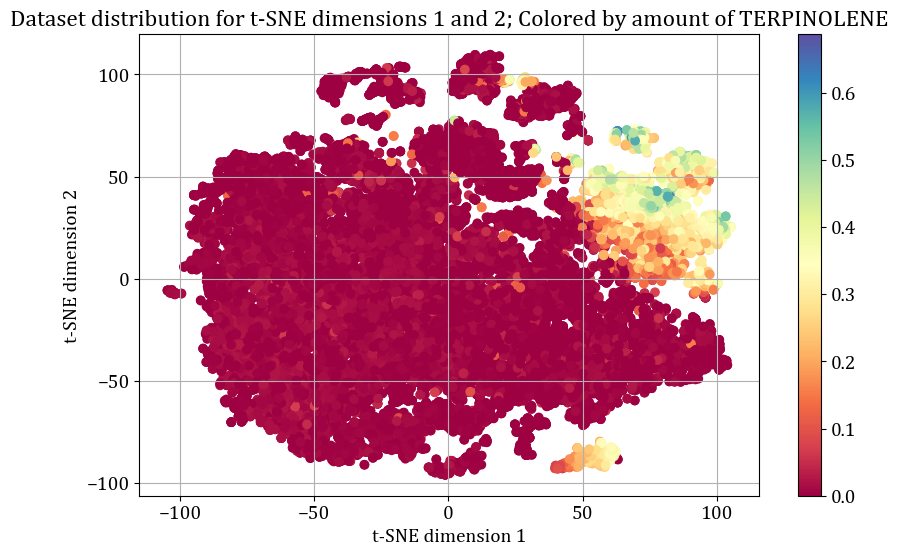

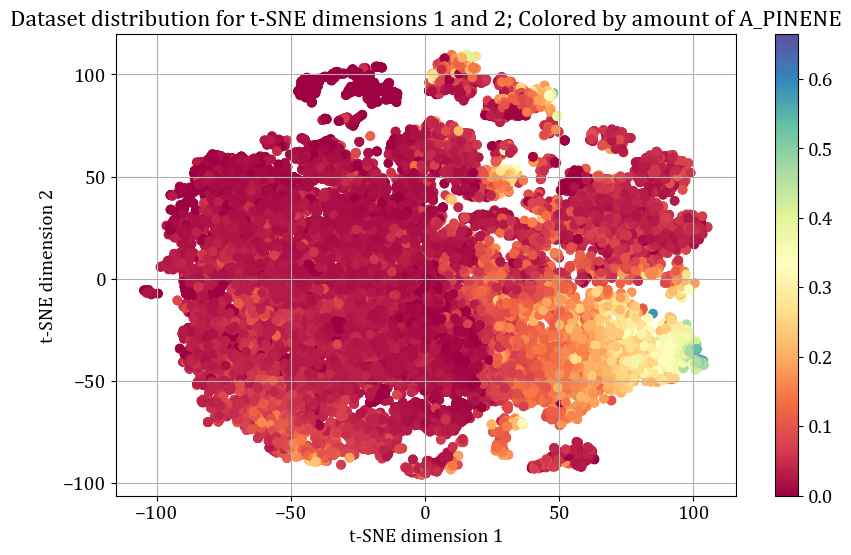

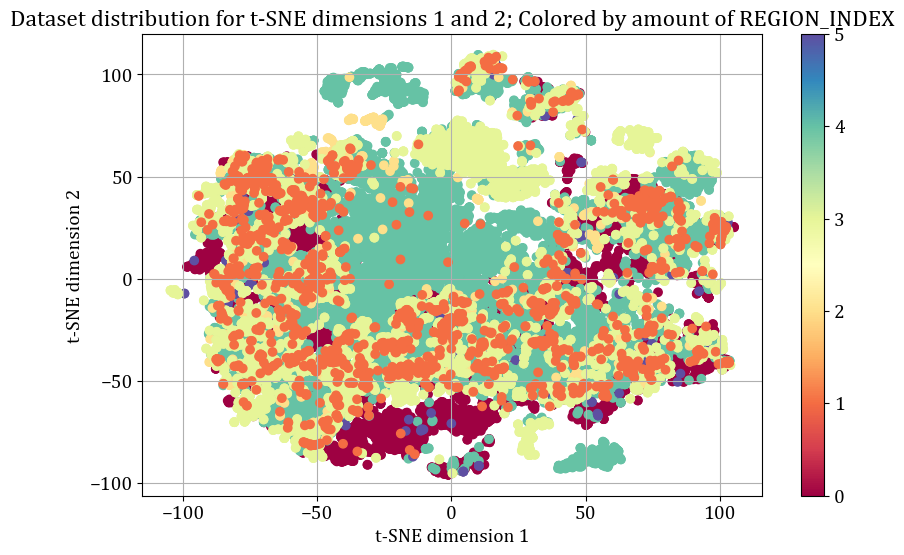

In [13]:
for i in df.columns[2:]:
    plt.scatter(df_tsne[0], df_tsne[1], c=df[i], cmap="Spectral")
    plt.colorbar()
    plt.xlabel("t-SNE dimension 1")
    plt.ylabel("t-SNE dimension 2")
    plt.title("Dataset distribution for t-SNE dimensions 1 and 2; Colored by amount of "+i.upper())
    plt.savefig(IPATH+"tsne_1_2_"+i+".png")
    plt.show()

ValueError: 'c' argument must be a color, a sequence of colors, or a sequence of numbers, not u_id
0        AK
1        AK
2        AK
3        AK
4        AK
         ..
88943    CA
88944    CA
88980    CA
88998    CA
88999    CA
Name: region, Length: 26033, dtype: object

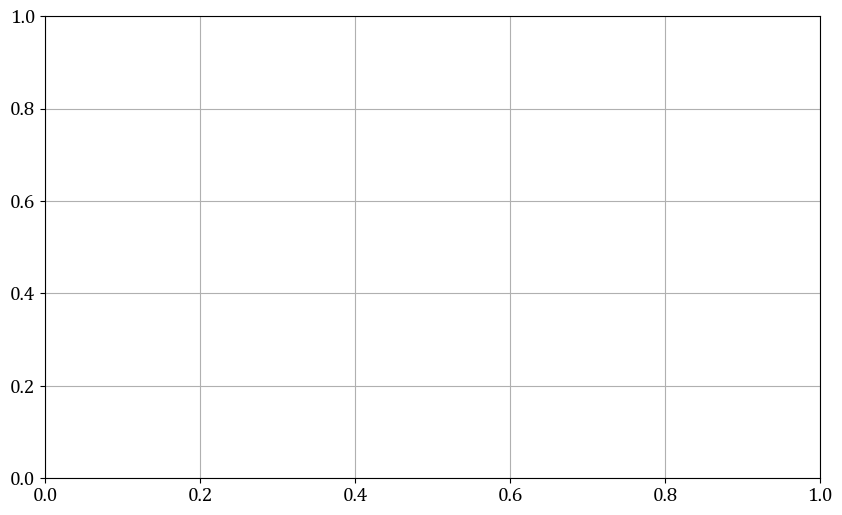

In [14]:
plt.scatter(df_tsne[0], df_tsne[1], c=df["region"], cmap="Spectral")
plt.colorbar()
plt.xlabel("t-SNE dimension 1")
plt.ylabel("t-SNE dimension 2")
plt.title("Dataset distribution for t-SNE dimensions 1 and 2; Colored by amount of "+i.upper())
plt.savefig(IPATH+"tsne_1_2_region.png")
plt.show()